In [2]:
import numpy as np
import pandas as pd
import os
import sklearn
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import f1_score,accuracy_score

In [3]:
!pip install -qq tqdm

In [4]:
!pip -qq install simpletransformers

In [5]:
!pip -qq install catboost xgboost

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [1]:
#model paths
tbert="/content/drive/MyDrive/Capstone/Models/Tamil/tbert_tamil.sav"
xlm="/content/drive/MyDrive/Capstone/Models/Tamil/xlm_roberta_tamil.sav"
distilbert="/content/drive/MyDrive/Capstone/Models/Tamil/distilbert_tamil.sav"
muril="/content/drive/MyDrive/Capstone/Models/Tamil/muril_tamil.sav"
mbert="/content/drive/MyDrive/Capstone/Models/Tamil/mbert_tamil.sav"
tamillion="/content/drive/MyDrive/Capstone/Models/Tamil/tamillion_tamil.sav"

In [11]:
import pickle
tbert_model=pickle.load(open(tbert,'rb'))
#xlm_model=pickle.load(open(xlm,'rb'))
#mbert_model=pickle.load(open(mbert,'rb'))
#distilbert_model=pickle.load(open(distilbert,'rb'))
#muril_model=pickle.load(open(muril,'rb'))
#tamillion_model=pickle.load(open(tamillion,'rb'))

In [7]:
colab_sample_data_path = '/content/sample_data'
os.chdir(colab_sample_data_path)

## Preprocessing the dataset (text to numerical feature vector)

In [8]:
from IPython.display import clear_output
from tqdm import tqdm
import numpy as np

def preprocess_dataset(df, model, training, batch_size):
    processed_text, labels = [], []
    problematic_inputs = []

    total_batches = (len(df) + batch_size - 1) // batch_size
    for i in tqdm(range(0, len(df), batch_size), total=total_batches, desc="Processing Data"):
        batch_texts = df['text'].iloc[i:i+batch_size].tolist()
        batch_labels = df['label'].iloc[i:i+batch_size].tolist()

        # Ensure batch_texts is a list of texts
        if not isinstance(batch_texts, list):
            batch_texts = [batch_texts]

        try:
            # Use batch processing for predictions
            batch_predictions = model.predict(batch_texts)
            processed_text.extend(batch_predictions[1])  # processed text
            labels.extend(batch_labels)
        except Exception as e:
            print(f"Error occurred during prediction: {e}")
            problematic_inputs.extend(batch_texts)

        clear_output(wait=True)

    #print("\nInputs causing the error:")
    #print(problematic_inputs)

    return np.array(processed_text), np.array(labels)


In [9]:
dataset2=pd.read_csv("/content/drive/MyDrive/Capstone/Dataset/Preprocessed/tamil_dataset_2_train.csv")
dataset2_filtered = dataset2[dataset2['label'] != 2]
X=list(dataset2_filtered['text'])
y=list(dataset2_filtered['label'])
X_train, X_test, y_train, y_test = train_test_split(X, y , random_state=42,test_size=0.3)
train_df = pd.DataFrame({"text": X_train, "label": y_train})
test_df = pd.DataFrame({"text": X_test, "label": y_test})

### TBERT Ensemble models for tamil text

In [12]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=tbert_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:26<00:00,  1.41s/it]


In [13]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=tbert_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:25<00:00,  1.47s/it]


#### SVM

In [14]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.89      0.90      0.89      9577
           1       0.67      0.64      0.66      3063

    accuracy                           0.84     12640
   macro avg       0.78      0.77      0.78     12640
weighted avg       0.84      0.84      0.84     12640

[[8625  952]
 [1098 1965]]


#### Decision tree

In [15]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.89      0.88      0.88      9697
           1       0.61      0.64      0.63      2943

    accuracy                           0.82     12640
   macro avg       0.75      0.76      0.75     12640
weighted avg       0.83      0.82      0.82     12640

[[8515 1182]
 [1062 1881]]


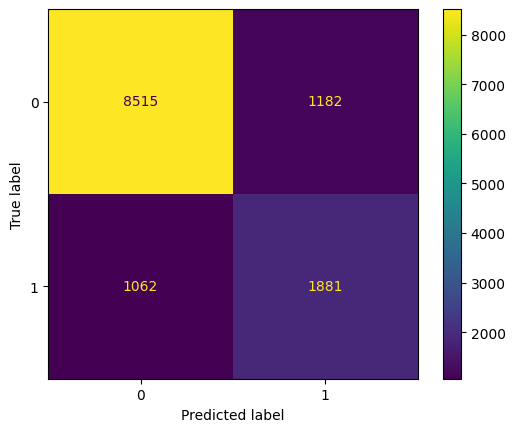

In [16]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [17]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8612  965]
 [1173 1890]]


In [18]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

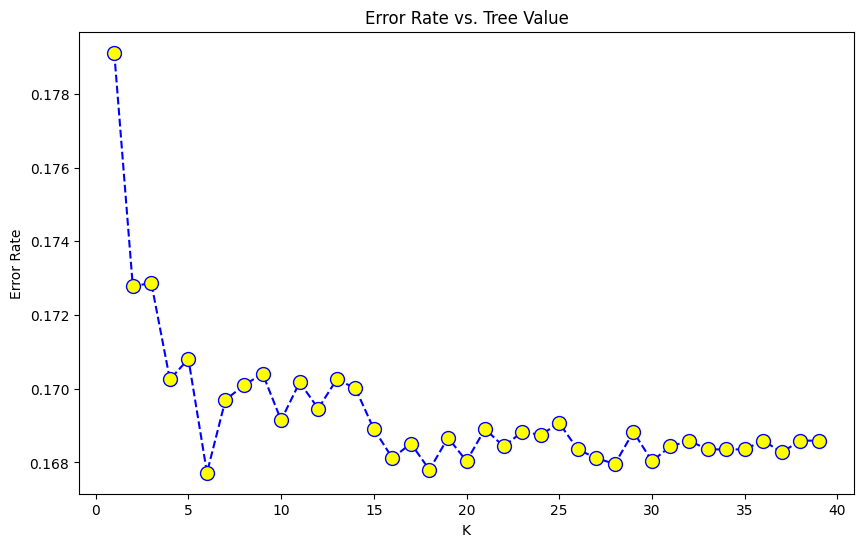

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [20]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.89      0.89      9577
           1       0.65      0.63      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8559 1018]
 [1141 1922]]


#### Xgboost classifier

In [21]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.89      0.89      9577
           1       0.65      0.63      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8559 1018]
 [1141 1922]]


In [22]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.91      0.89      9577
           1       0.68      0.62      0.65      3063

    accuracy                           0.84     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.84      0.84     12640

Confusion Matrix:
[[8695  882]
 [1166 1897]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200}


#### Catboost classifier

In [23]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.6144141	total: 54.1ms	remaining: 54s
1:	learn: 0.5448615	total: 60.2ms	remaining: 30s
2:	learn: 0.4853883	total: 67.3ms	remaining: 22.4s
3:	learn: 0.4359443	total: 73.7ms	remaining: 18.3s
4:	learn: 0.3922624	total: 80ms	remaining: 15.9s
5:	learn: 0.3540954	total: 85.9ms	remaining: 14.2s
6:	learn: 0.3217331	total: 92.9ms	remaining: 13.2s
7:	learn: 0.2938347	total: 103ms	remaining: 12.7s
8:	learn: 0.2702272	total: 109ms	remaining: 12s
9:	learn: 0.2503669	total: 115ms	remaining: 11.4s
10:	learn: 0.2328316	total: 122ms	remaining: 10.9s
11:	learn: 0.2192550	total: 128ms	remaining: 10.5s
12:	learn: 0.2065294	total: 134ms	remaining: 10.2s
13:	learn: 0.1949632	total: 140ms	remaining: 9.88s
14:	learn: 0.1846890	total: 149ms	remaining: 9.79s
15:	learn: 0.1757288	total: 156ms	remaining: 9.57s
16:	learn: 0.1681263	total: 162ms	remaining: 9.35s
17:	learn: 0.1614974	total: 167ms	remaining: 9.13s
18:	learn: 0.1563309	total: 174ms	remaining: 8.97s
19:	learn: 0

In [24]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.90      0.89      9577
           1       0.67      0.64      0.66      3063

    accuracy                           0.84     12640
   macro avg       0.78      0.77      0.78     12640
weighted avg       0.84      0.84      0.84     12640

Confusion Matrix:
[[8613  964]
 [1089 1974]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.1}


In [25]:
import pickle
with open('tamil_catboost_tbert_classifier.sav', 'wb') as f:
    pickle.dump(best_classifier, f)

In [26]:
import shutil

local_model_path = '/content/sample_data/tamil_catboost_tbert_classifier.sav'
destination_path = '/content/drive/MyDrive/Capstone/Models/Classifiers/tamil_catboost_tbert_classifier.sav'

# Copy the file to the destination directory
shutil.copy(local_model_path, destination_path)


'/content/drive/MyDrive/Capstone/Models/Classifiers/tamil_catboost_tbert_classifier.sav'

### XLM_RoBERTa Ensemble models for tamil text

In [26]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=xlm_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [08:20<00:00,  2.17s/it]


In [27]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=xlm_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [03:38<00:00,  2.21s/it]


#### SVM

In [28]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.63      0.65      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8572 1005]
 [1119 1944]]


#### Decision tree

In [29]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.89      0.88      0.89      9721
           1       0.62      0.65      0.64      2919

    accuracy                           0.83     12640
   macro avg       0.76      0.77      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8558 1163]
 [1019 1900]]


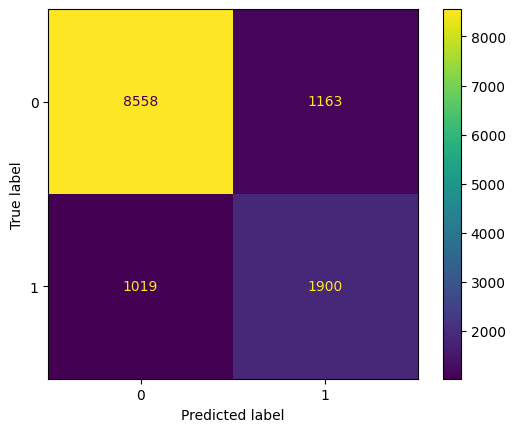

In [30]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [31]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8625  952]
 [1166 1897]]


In [32]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

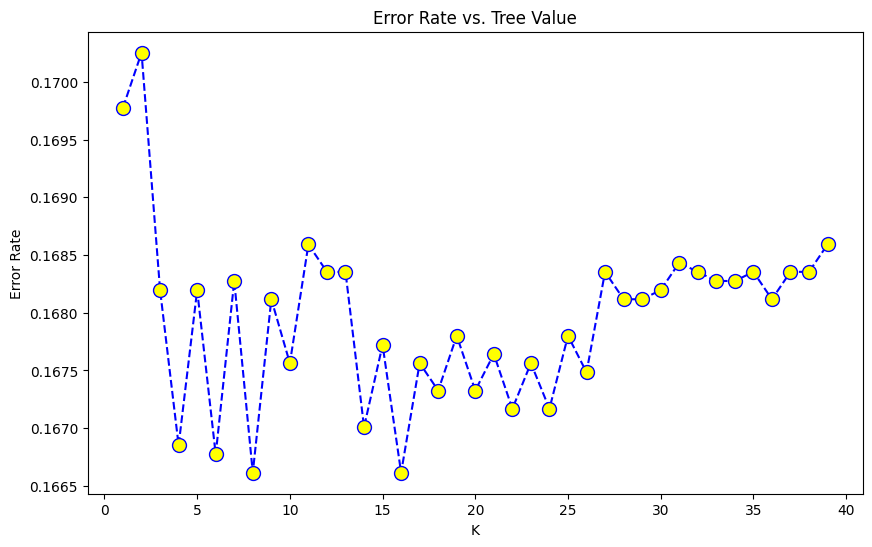

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [34]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8602  975]
 [1151 1912]]


#### Xgboost classifier

In [35]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.62      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

[[8602  975]
 [1151 1912]]


In [36]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.61      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8664  913]
 [1182 1881]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300}


#### Catboost classifier

In [37]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5727262	total: 7.22ms	remaining: 7.21s
1:	learn: 0.4695148	total: 12.9ms	remaining: 6.45s
2:	learn: 0.3854342	total: 18.7ms	remaining: 6.21s
3:	learn: 0.3219562	total: 24.4ms	remaining: 6.08s
4:	learn: 0.2680579	total: 31.2ms	remaining: 6.21s
5:	learn: 0.2236449	total: 37.3ms	remaining: 6.18s
6:	learn: 0.1903459	total: 43.5ms	remaining: 6.17s
7:	learn: 0.1633750	total: 49.6ms	remaining: 6.15s
8:	learn: 0.1428646	total: 56ms	remaining: 6.17s
9:	learn: 0.1251893	total: 62.6ms	remaining: 6.19s
10:	learn: 0.1112520	total: 68.5ms	remaining: 6.16s
11:	learn: 0.0990279	total: 74.7ms	remaining: 6.15s
12:	learn: 0.0892079	total: 80.8ms	remaining: 6.14s
13:	learn: 0.0818212	total: 86.9ms	remaining: 6.12s
14:	learn: 0.0752082	total: 93ms	remaining: 6.1s
15:	learn: 0.0695641	total: 99ms	remaining: 6.09s
16:	learn: 0.0640936	total: 105ms	remaining: 6.09s
17:	learn: 0.0596210	total: 114ms	remaining: 6.22s
18:	learn: 0.0558516	total: 120ms	remaining: 6.21s
19

In [38]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.67      0.61      0.64      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.76      0.77     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8665  912]
 [1185 1878]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.05}


### DistilBERT Ensemble models for tamil text

In [39]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=distilbert_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:21<00:00,  1.39s/it]


In [40]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=distilbert_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:21<00:00,  1.43s/it]


#### SVM

In [41]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.60      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.75     12640
weighted avg       0.81      0.82      0.82     12640

[[8512 1065]
 [1240 1823]]


#### Decision tree

In [42]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.88      0.87      0.87      9686
           1       0.59      0.61      0.60      2954

    accuracy                           0.81     12640
   macro avg       0.73      0.74      0.74     12640
weighted avg       0.81      0.81      0.81     12640

[[8426 1260]
 [1151 1803]]


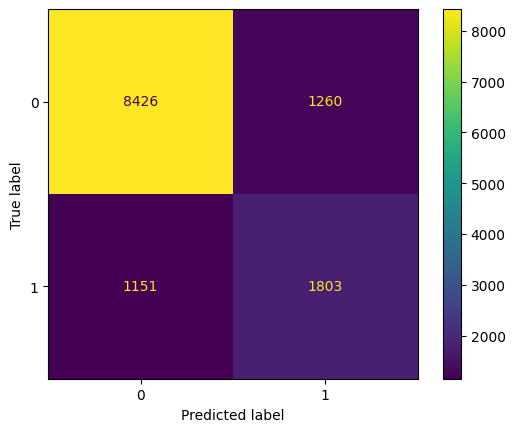

In [43]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [44]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.64      0.58      0.60      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.74     12640
weighted avg       0.81      0.82      0.81     12640

[[8566 1011]
 [1297 1766]]


In [45]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

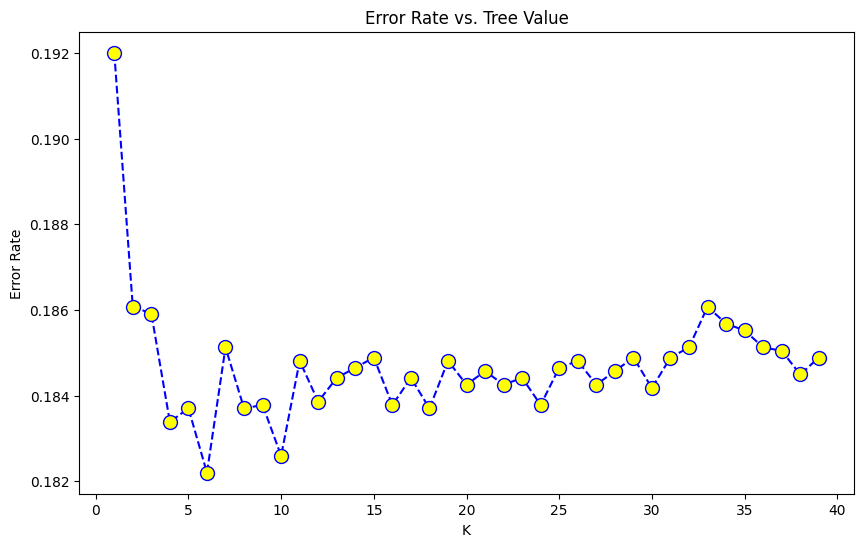

In [46]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [47]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.60      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.75     12640
weighted avg       0.81      0.82      0.81     12640

[[8491 1086]
 [1236 1827]]


#### Xgboost classifier

In [48]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.60      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.75     12640
weighted avg       0.81      0.82      0.81     12640

[[8491 1086]
 [1236 1827]]


In [49]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.60      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.75     12640
weighted avg       0.81      0.82      0.82     12640

Confusion Matrix:
[[8509 1068]
 [1231 1832]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300}


#### Catboost classifier

In [50]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.6000521	total: 6.74ms	remaining: 6.73s
1:	learn: 0.5231932	total: 12.6ms	remaining: 6.28s
2:	learn: 0.4617509	total: 18.2ms	remaining: 6.05s
3:	learn: 0.4126362	total: 24.3ms	remaining: 6.05s
4:	learn: 0.3723303	total: 30.2ms	remaining: 6.01s
5:	learn: 0.3348663	total: 36ms	remaining: 5.96s
6:	learn: 0.3055904	total: 41.9ms	remaining: 5.95s
7:	learn: 0.2800133	total: 47.8ms	remaining: 5.92s
8:	learn: 0.2599267	total: 53.8ms	remaining: 5.92s
9:	learn: 0.2427778	total: 60ms	remaining: 5.94s
10:	learn: 0.2277383	total: 65.9ms	remaining: 5.93s
11:	learn: 0.2157311	total: 72.2ms	remaining: 5.95s
12:	learn: 0.2057123	total: 78.1ms	remaining: 5.93s
13:	learn: 0.1959450	total: 84ms	remaining: 5.92s
14:	learn: 0.1886583	total: 89.9ms	remaining: 5.9s
15:	learn: 0.1817342	total: 95.8ms	remaining: 5.89s
16:	learn: 0.1759114	total: 101ms	remaining: 5.86s
17:	learn: 0.1705782	total: 107ms	remaining: 5.84s
18:	learn: 0.1661148	total: 113ms	remaining: 5.84s
19

In [51]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.89      0.88      9577
           1       0.63      0.59      0.61      3063

    accuracy                           0.82     12640
   macro avg       0.75      0.74      0.75     12640
weighted avg       0.81      0.82      0.82     12640

Confusion Matrix:
[[8513 1064]
 [1241 1822]]
Best Parameters: {'depth': 3, 'iterations': 200, 'learning_rate': 0.05}


### mBERT Ensemble models for tamil text

In [52]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=mbert_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:21<00:00,  1.39s/it]


In [53]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=mbert_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:20<00:00,  1.42s/it]


#### SVM

In [54]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.67      0.58      0.62      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.82      0.83      0.83     12640

[[8699  878]
 [1277 1786]]


#### Decision tree

In [55]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.91      0.87      0.89     10095
           1       0.56      0.67      0.61      2545

    accuracy                           0.83     12640
   macro avg       0.74      0.77      0.75     12640
weighted avg       0.84      0.83      0.83     12640

[[8748 1347]
 [ 829 1716]]


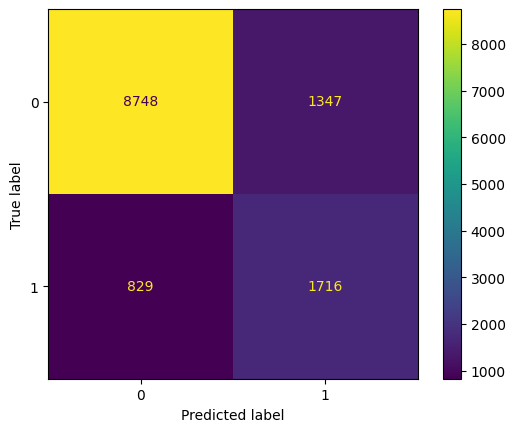

In [56]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [57]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.67      0.58      0.62      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.74      0.76     12640
weighted avg       0.82      0.83      0.82     12640

[[8707  870]
 [1290 1773]]


In [58]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

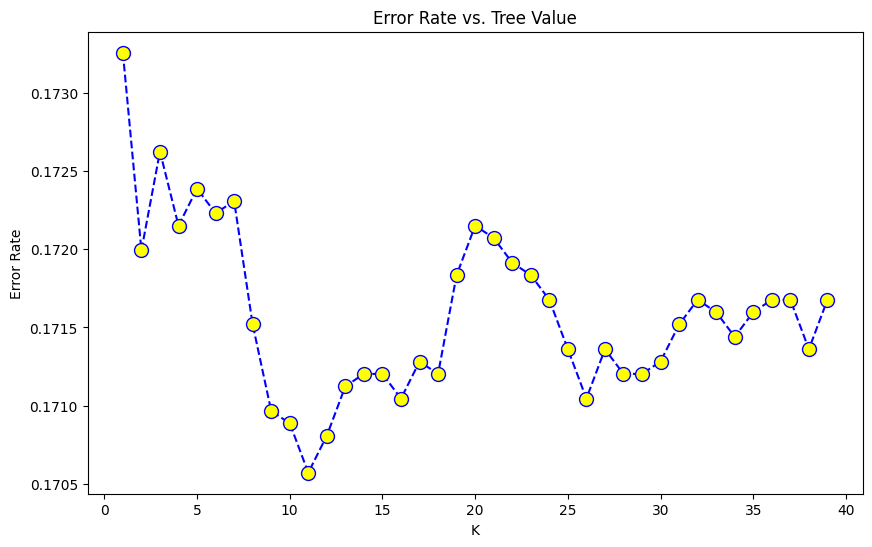

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [60]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.67      0.57      0.62      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.74      0.75     12640
weighted avg       0.82      0.83      0.82     12640

[[8713  864]
 [1315 1748]]


#### Xgboost classifier

In [61]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.67      0.57      0.62      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.74      0.75     12640
weighted avg       0.82      0.83      0.82     12640

[[8713  864]
 [1315 1748]]


In [62]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.61      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8614  963]
 [1195 1868]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}


#### Catboost classifier

In [63]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5398170	total: 6.97ms	remaining: 6.97s
1:	learn: 0.4173281	total: 12.9ms	remaining: 6.43s
2:	learn: 0.3253362	total: 18.7ms	remaining: 6.22s
3:	learn: 0.2558370	total: 25ms	remaining: 6.22s
4:	learn: 0.2021575	total: 31.1ms	remaining: 6.19s
5:	learn: 0.1531905	total: 37.2ms	remaining: 6.16s
6:	learn: 0.1201737	total: 43.4ms	remaining: 6.16s
7:	learn: 0.0952364	total: 49.9ms	remaining: 6.18s
8:	learn: 0.0757961	total: 55.8ms	remaining: 6.14s
9:	learn: 0.0610751	total: 61.9ms	remaining: 6.13s
10:	learn: 0.0482056	total: 68.1ms	remaining: 6.12s
11:	learn: 0.0399939	total: 75.1ms	remaining: 6.19s
12:	learn: 0.0331300	total: 82.5ms	remaining: 6.26s
13:	learn: 0.0273702	total: 88.6ms	remaining: 6.24s
14:	learn: 0.0231930	total: 94.8ms	remaining: 6.22s
15:	learn: 0.0200130	total: 101ms	remaining: 6.2s
16:	learn: 0.0173328	total: 107ms	remaining: 6.18s
17:	learn: 0.0151803	total: 113ms	remaining: 6.16s
18:	learn: 0.0134571	total: 119ms	remaining: 6.13s

In [64]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.90      0.89      9577
           1       0.66      0.61      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.82      0.83      0.83     12640

Confusion Matrix:
[[8620  957]
 [1202 1861]]
Best Parameters: {'depth': 3, 'iterations': 100, 'learning_rate': 0.05}


### Muril Ensemble models for tamil text

In [65]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=muril_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [06:03<00:00,  1.57s/it]


In [66]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=muril_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:38<00:00,  1.60s/it]


#### SVM

In [67]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.68      0.59      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.75      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8748  829]
 [1267 1796]]


#### Decision tree

In [68]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.91      0.87      0.89      9972
           1       0.58      0.67      0.62      2668

    accuracy                           0.83     12640
   macro avg       0.74      0.77      0.75     12640
weighted avg       0.84      0.83      0.83     12640

[[8688 1284]
 [ 889 1779]]


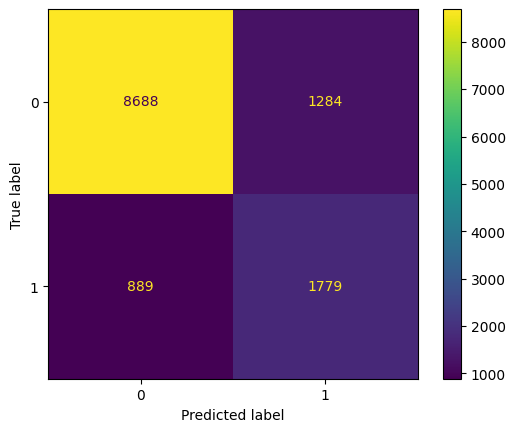

In [69]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [70]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.68      0.58      0.62      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.75      0.76     12640
weighted avg       0.83      0.83      0.83     12640

[[8756  821]
 [1298 1765]]


In [71]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

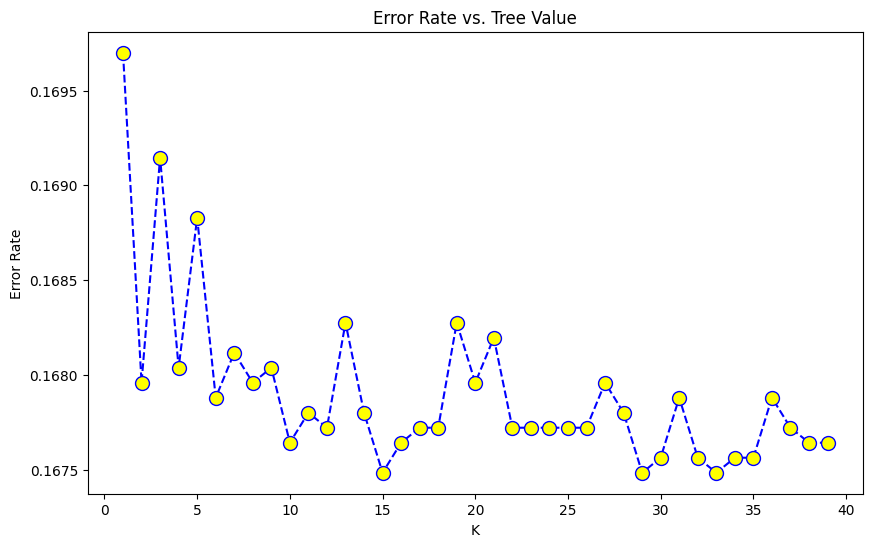

In [72]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [73]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.68      0.58      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.82      0.83      0.83     12640

[[8722  855]
 [1279 1784]]


#### Xgboost classifier

In [74]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.87      0.91      0.89      9577
           1       0.68      0.58      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.77      0.75      0.76     12640
weighted avg       0.82      0.83      0.83     12640

[[8722  855]
 [1279 1784]]


In [75]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.92      0.89      9577
           1       0.69      0.57      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.75      0.76     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8791  786]
 [1307 1756]]
Best Parameters: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}


#### Catboost classifier

In [76]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.5835666	total: 6.89ms	remaining: 6.89s
1:	learn: 0.4902590	total: 12.8ms	remaining: 6.38s
2:	learn: 0.4145235	total: 18.7ms	remaining: 6.21s
3:	learn: 0.3507768	total: 24.5ms	remaining: 6.09s
4:	learn: 0.2987876	total: 30.2ms	remaining: 6s
5:	learn: 0.2538839	total: 37.9ms	remaining: 6.29s
6:	learn: 0.2178436	total: 43.7ms	remaining: 6.2s
7:	learn: 0.1888841	total: 50.4ms	remaining: 6.25s
8:	learn: 0.1647106	total: 56.7ms	remaining: 6.25s
9:	learn: 0.1439116	total: 62.4ms	remaining: 6.17s
10:	learn: 0.1269423	total: 68ms	remaining: 6.12s
11:	learn: 0.1139099	total: 73.9ms	remaining: 6.08s
12:	learn: 0.1018641	total: 79.9ms	remaining: 6.07s
13:	learn: 0.0918356	total: 86ms	remaining: 6.06s
14:	learn: 0.0835689	total: 91.9ms	remaining: 6.04s
15:	learn: 0.0764959	total: 98ms	remaining: 6.03s
16:	learn: 0.0701739	total: 104ms	remaining: 6.02s
17:	learn: 0.0650381	total: 110ms	remaining: 6s
18:	learn: 0.0607972	total: 115ms	remaining: 5.96s
19:	lear

In [77]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.92      0.89      9577
           1       0.69      0.57      0.63      3063

    accuracy                           0.83     12640
   macro avg       0.78      0.75      0.76     12640
weighted avg       0.83      0.83      0.83     12640

Confusion Matrix:
[[8792  785]
 [1307 1756]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.05}


### Tamillion Ensemble models for tamil text

In [78]:
 #get the features vector and their labels (training set)
X_train,y_train=preprocess_dataset(train_df,
                                   model=tamillion_model,
                                   training=True,
                                   batch_size=128)

Processing Data: 100%|██████████| 231/231 [05:15<00:00,  1.37s/it]


In [79]:
#get the features vector and their labels (testing set)
X_test,y_test=preprocess_dataset(test_df,
                                 model=tamillion_model,
                                 training=False,
                                 batch_size=128)

Processing Data: 100%|██████████| 99/99 [02:16<00:00,  1.38s/it]


#### SVM

In [80]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
svm_classifier = SVC(kernel='rbf', random_state=42)
svm_classifier.fit(X_train, y_train)
pred_svm = svm_classifier.predict(X_test)
print(classification_report(y_test, pred_svm))
print(confusion_matrix(y_test, pred_svm))

              precision    recall  f1-score   support

           0       0.86      0.89      0.87      9577
           1       0.61      0.55      0.58      3063

    accuracy                           0.81     12640
   macro avg       0.74      0.72      0.73     12640
weighted avg       0.80      0.81      0.80     12640

[[8521 1056]
 [1382 1681]]


#### Decision tree

In [81]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report,confusion_matrix
clf=DecisionTreeClassifier(criterion='entropy',random_state=42)
clf.fit(X_train,y_train)
pred_dtc=clf.predict(X_test)
print(classification_report(pred_dtc,y_test))
print(confusion_matrix(pred_dtc,y_test))

              precision    recall  f1-score   support

           0       0.87      0.85      0.86      9717
           1       0.54      0.56      0.55      2923

    accuracy                           0.79     12640
   macro avg       0.70      0.71      0.71     12640
weighted avg       0.79      0.79      0.79     12640

[[8304 1413]
 [1273 1650]]


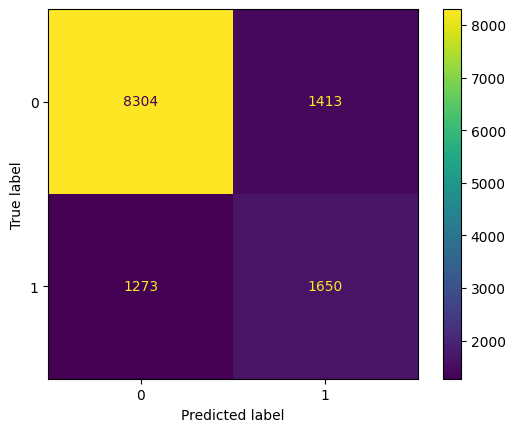

In [82]:
from sklearn.metrics import ConfusionMatrixDisplay
fig=ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(pred_dtc,y_test),display_labels=clf.classes_)
fig.plot()

#### Random forest

In [83]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=10,criterion='entropy',random_state=42)
rfc.fit(X_train,y_train)
pred_rfc = rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.89      0.87      9577
           1       0.60      0.54      0.57      3063

    accuracy                           0.80     12640
   macro avg       0.73      0.71      0.72     12640
weighted avg       0.79      0.80      0.80     12640

[[8480 1097]
 [1417 1646]]


In [84]:
#find the best tree value
error_rate = []

for i in range(1,40):
    rfc = RandomForestClassifier(n_estimators=i,criterion='entropy',random_state=42)
    rfc.fit(X_train,y_train)
    pred_i = rfc.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

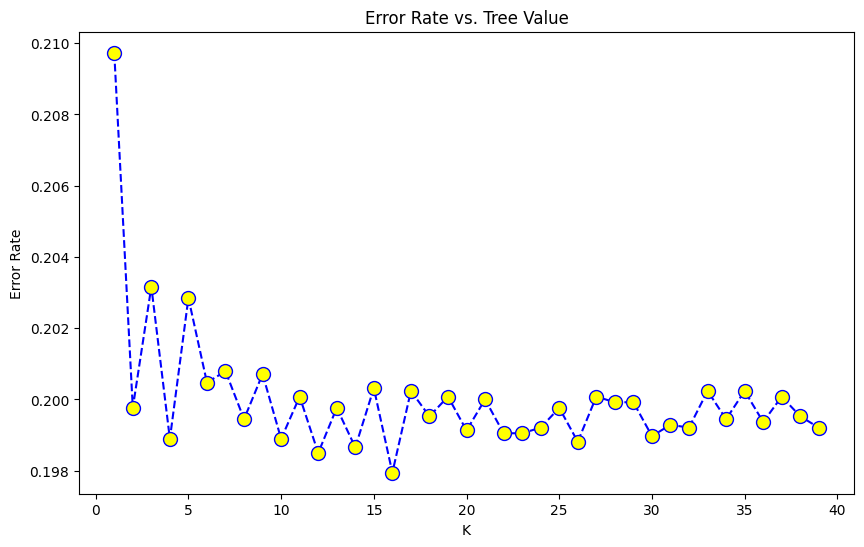

In [85]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='yellow', markersize=10)
plt.title('Error Rate vs. Tree Value')
plt.xlabel('K')
plt.ylabel('Error Rate') #error rate decrease as the tree value increases

In [86]:
rfc = RandomForestClassifier(n_estimators=5,criterion='entropy',random_state=42) #12- trees from elbow method
rfc.fit(X_train,y_train)
pred_rfc= rfc.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.87      0.87      9577
           1       0.58      0.56      0.57      3063

    accuracy                           0.80     12640
   macro avg       0.72      0.72      0.72     12640
weighted avg       0.79      0.80      0.80     12640

[[8351 1226]
 [1338 1725]]


#### Xgboost classifier

In [87]:
from xgboost import XGBClassifier
classifier=XGBClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

              precision    recall  f1-score   support

           0       0.86      0.87      0.87      9577
           1       0.58      0.56      0.57      3063

    accuracy                           0.80     12640
   macro avg       0.72      0.72      0.72     12640
weighted avg       0.79      0.80      0.80     12640

[[8351 1226]
 [1338 1725]]


In [88]:
from xgboost import XGBClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix

# Define the XGBoost classifier
classifier = XGBClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Perform grid search cross-validation
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data
grid_search.fit(X_train, y_train)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_xgb = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_xgb))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_xgb))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 27 candidates, totalling 81 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.88      0.87      9577
           1       0.60      0.56      0.58      3063

    accuracy                           0.80     12640
   macro avg       0.73      0.72      0.73     12640
weighted avg       0.80      0.80      0.80     12640

Confusion Matrix:
[[8434 1143]
 [1340 1723]]
Best Parameters: {'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 300}


#### Catboost classifier

In [89]:
from catboost import CatBoostClassifier
classifier=CatBoostClassifier()
classifier.fit(X_train,y_train)
pred_xgb= classifier.predict(X_test)
print(classification_report(y_test,pred_rfc))
print(confusion_matrix(y_test,pred_rfc))

Learning rate set to 0.043621
0:	learn: 0.6049324	total: 6.98ms	remaining: 6.98s
1:	learn: 0.5347730	total: 12.9ms	remaining: 6.46s
2:	learn: 0.4847435	total: 18.6ms	remaining: 6.18s
3:	learn: 0.4465144	total: 24.9ms	remaining: 6.21s
4:	learn: 0.4045307	total: 30.9ms	remaining: 6.14s
5:	learn: 0.3726957	total: 36.9ms	remaining: 6.12s
6:	learn: 0.3438617	total: 44.2ms	remaining: 6.27s
7:	learn: 0.3224723	total: 50.3ms	remaining: 6.24s
8:	learn: 0.3047102	total: 56.3ms	remaining: 6.2s
9:	learn: 0.2907342	total: 62.3ms	remaining: 6.17s
10:	learn: 0.2775334	total: 68.4ms	remaining: 6.15s
11:	learn: 0.2648769	total: 74.6ms	remaining: 6.14s
12:	learn: 0.2546168	total: 80.7ms	remaining: 6.13s
13:	learn: 0.2435766	total: 90.4ms	remaining: 6.37s
14:	learn: 0.2351534	total: 104ms	remaining: 6.84s
15:	learn: 0.2288433	total: 114ms	remaining: 6.99s
16:	learn: 0.2222727	total: 119ms	remaining: 6.9s
17:	learn: 0.2171415	total: 128ms	remaining: 6.98s
18:	learn: 0.2128616	total: 134ms	remaining: 6.93s

In [90]:
from catboost import CatBoostClassifier
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report, confusion_matrix

# Define the CatBoost classifier
classifier = CatBoostClassifier()

# Define the parameter grid for hyperparameter tuning
param_grid = {
    'iterations': [100, 200],
    'depth': [3, 5],
    'learning_rate': [0.05, 0.1]
}

# Define stratified k-fold cross-validation
cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

# Perform grid search cross-validation with early stopping
grid_search = GridSearchCV(estimator=classifier, param_grid=param_grid, cv=cv, scoring='accuracy', verbose=2, n_jobs=-1)

# Fit the grid search to the data with early stopping
grid_search.fit(X_train, y_train, early_stopping_rounds=10, eval_set=(X_test, y_test), verbose=False)

# Get the best model
best_classifier = grid_search.best_estimator_

# Make predictions with the best model
pred_catboost = best_classifier.predict(X_test)

# Print classification report and confusion matrix
print("Classification Report:")
print(classification_report(y_test, pred_catboost))
print("Confusion Matrix:")
print(confusion_matrix(y_test, pred_catboost))

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 8 candidates, totalling 24 fits
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.88      0.87      9577
           1       0.60      0.57      0.58      3063

    accuracy                           0.80     12640
   macro avg       0.73      0.72      0.73     12640
weighted avg       0.80      0.80      0.80     12640

Confusion Matrix:
[[8413 1164]
 [1326 1737]]
Best Parameters: {'depth': 5, 'iterations': 100, 'learning_rate': 0.05}
